<a href="https://colab.research.google.com/github/PRAN20/Texture-Plotting-with-Plotly/blob/main/Texture_Mapping.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!git clone https://github.com/empet/Texture-mapping-with-Plotly.git

Cloning into 'Texture-mapping-with-Plotly'...
remote: Enumerating objects: 56, done.
remote: Counting objects: 100% (56/56), done.
remote: Compressing objects: 100% (51/51), done.
remote: Total 56 (delta 13), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (56/56), done.


In [7]:
cd /content/Texture-mapping-with-Plotly

/content/Texture-mapping-with-Plotly


In [4]:
import numpy as np
from numpy import pi, sin, cos
import skimage.io as sio
import plotly.graph_objs as go
import plotly.express as px
import plotly.io as pio
from texture import *
from utils import *


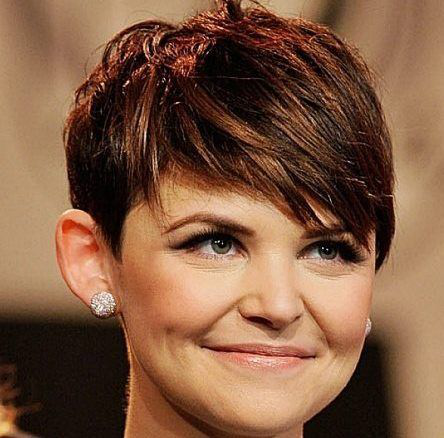

In [20]:
imgs = ["short-crop-hairstyles-for-round-faces-45_4.jpg" , "street-exhibition.jpg"]
img1 = sio.imread(f"images/{imgs[0]}") 
px.imshow(img1)

In [21]:
z_data, pl_colorscale = image2zvals(img1, n_colors=32, n_training_pixels=2000)
fig1 = go.Figure(go.Heatmap(z=np.flipud(z_data), colorscale=pl_colorscale))
fig1.update_layout(title_text="Image represented as a heatmap", title_x=0.5,
           width=600, height=600)
fig1.show()

In [22]:
r, c, _  = img1.shape
x, y, z = surface(r, c)

In [23]:
fig2 = go.Figure(go.Surface(x=x[0, :], y = np.flipud(y[:, 0]), z=z, 
                            surfacecolor=z_data, colorscale=pl_colorscale))
fig2.update_layout(width=600, height=600, **scene_style,
                  scene_camera_eye=dict(x=-2, y=-2, z=1.5))
fig2.show()

In [24]:
I, J, K, tri_color_intensity, pl_colorscale = mesh_data(img1, n_colors=32, n_training_pixels=5000) 
fig3 = go.Figure(go.Mesh3d(x=x.flatten(), y=np.flipud(y).flatten(), z=z.flatten(), 
                            i=I, j=J, k=K, intensity=tri_color_intensity, intensitymode="cell", 
                            colorscale=pl_colorscale, showscale=False))
fig3.update_layout(width=500, height=500,
                  margin=dict(t=5, r=5, b=5, l=5), 
                  scene_camera_eye=dict(x=-2, y=-2, z=1.5),
                  **scene_style)
fig3.show()